<a href="https://colab.research.google.com/github/seunghoonss/AI-HACKATHON/blob/main/Cross.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
import os
import sys
sys.path.append('/content/gdrive/MyDrive/crosswalk-traffic-light-detection-yolov5-master')


import torch
import numpy as np
import cv2

from utils.datasets import letterbox
from utils.general import non_max_suppression, scale_coords
from utils.plots import Annotator


In [3]:
# 횡단보도, 신호등 모델 # Yolov5
MODEL_PATH = '/content/gdrive/MyDrive/cross/best.pt'

img_size = 640
conf_thres = 0.5  # confidence threshold
iou_thres = 0.45  # NMS IOU threshold
max_det = 1000  # maximum detections per image
classes = None  # filter by class
agnostic_nms = False  # class-agnostic NMS

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
ckpt = torch.load(MODEL_PATH, map_location=device)
model = ckpt['ema' if ckpt.get('ema') else 'model'].float().fuse().eval()
class_names = ['횡단보도', '빨간불', '초록불'] # model.names
stride = int(model.stride.max())
colors = ((50, 50, 50), (0, 0, 255), (0, 255, 0)) # (gray, red, green)

In [4]:
import cv2
from google.colab.patches import cv2_imshow

# 차량,번호판 모델 # Yolov4
CONFIDENCE = 0.5
THRESHOLD = 0.3
LABELS = ['차량', '번호판']

net = cv2.dnn.readNetFromDarknet('/content/gdrive/MyDrive/ANPR/ANPR-with-Yolov4-master/cfg/yolov4-ANPR.cfg', '/content/gdrive/MyDrive/ANPR/yolov4-ANPR.weights')

#video_path = '/content/gdrive/MyDrive/crosswalk-traffic-light-detection-yolov5-master/data/full3_AdobeExpress.mp4'
#cap = cv2.VideoCapture(video_path)

#fourcc = cv2.VideoWriter_fourcc('m', 'p', '4', 'v')
#out = cv2.VideoWriter('%s_output1.mp4' % (video_path.split('.')[0]), fourcc, cap.get(cv2.CAP_PROP_FPS), (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))))



# 동영상 로드
cap = cv2.VideoCapture('/content/gdrive/MyDrive/crosswalk-traffic-light-detection-yolov5-master/data/sample.mp4')

# 동영상 결과 부분 저장
fourcc = cv2.VideoWriter_fourcc('m', 'p', '4', 'v')
out = cv2.VideoWriter('/content/gdrive/MyDrive/crosswalk-traffic-light-detection-yolov5-master/data/output2.mp4', fourcc, cap.get(cv2.CAP_PROP_FPS), (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))))


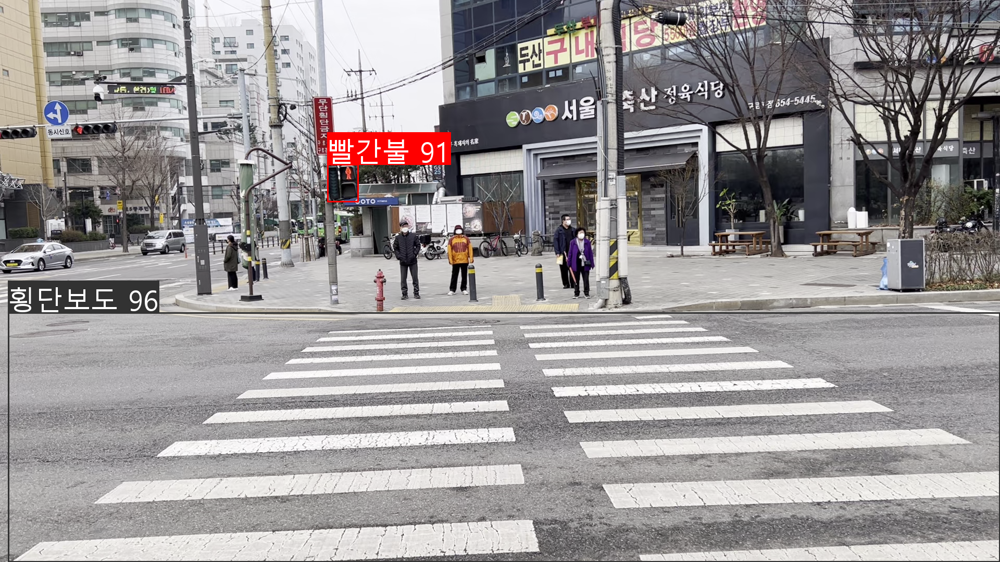

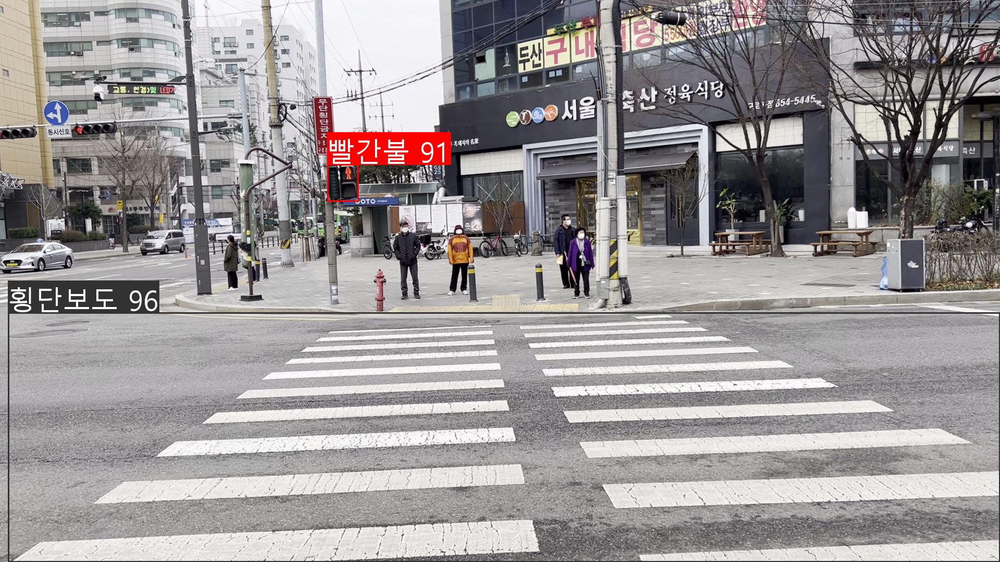

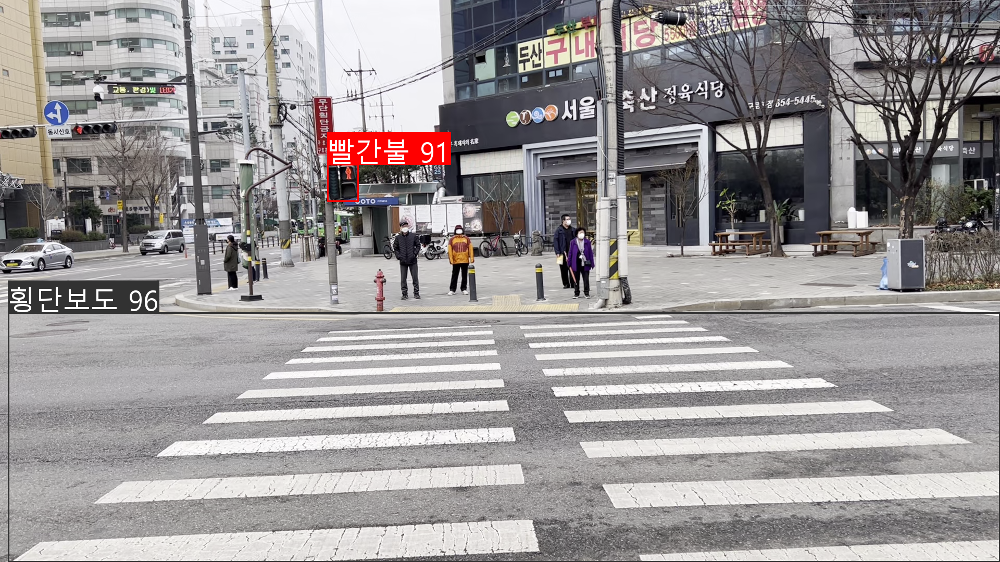

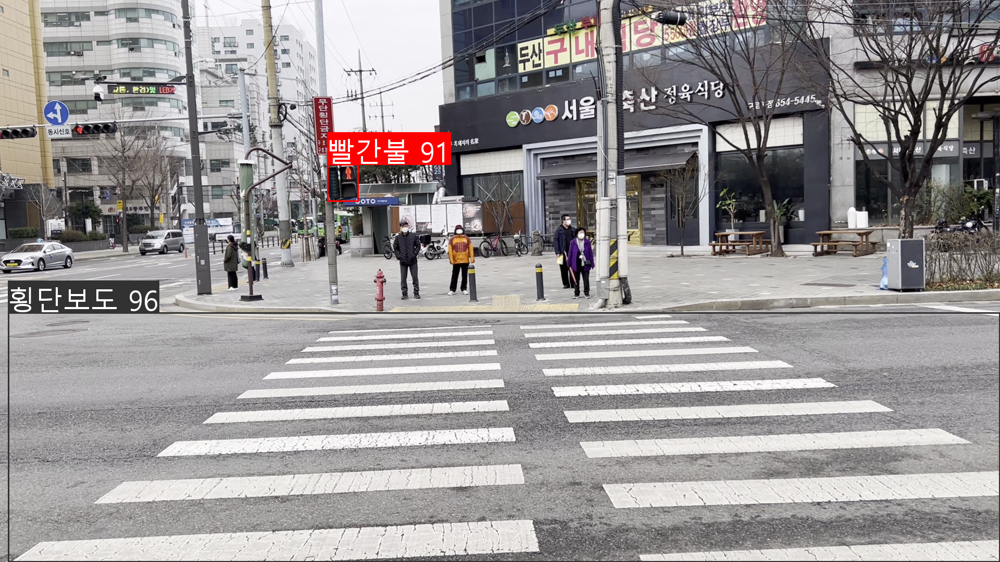

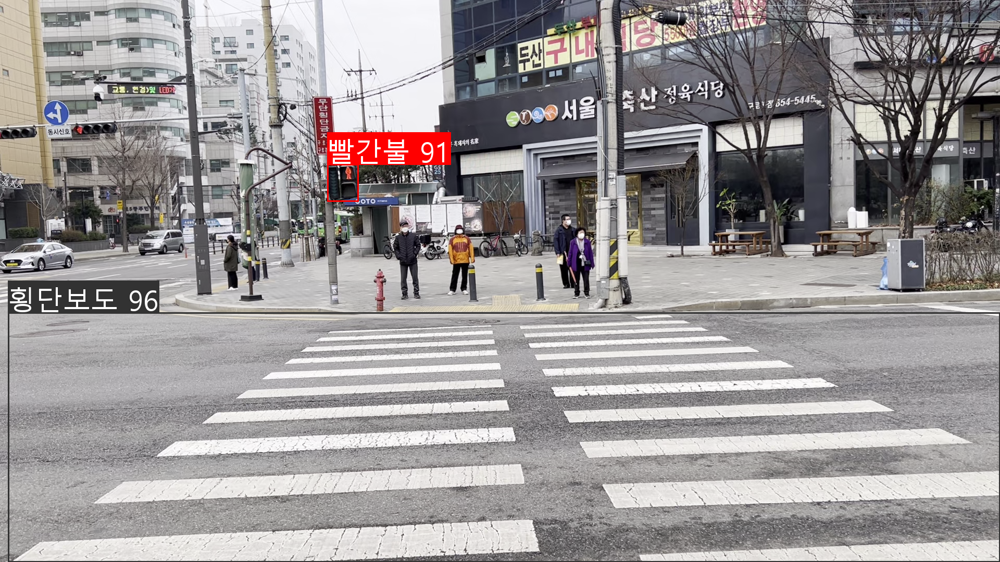

...

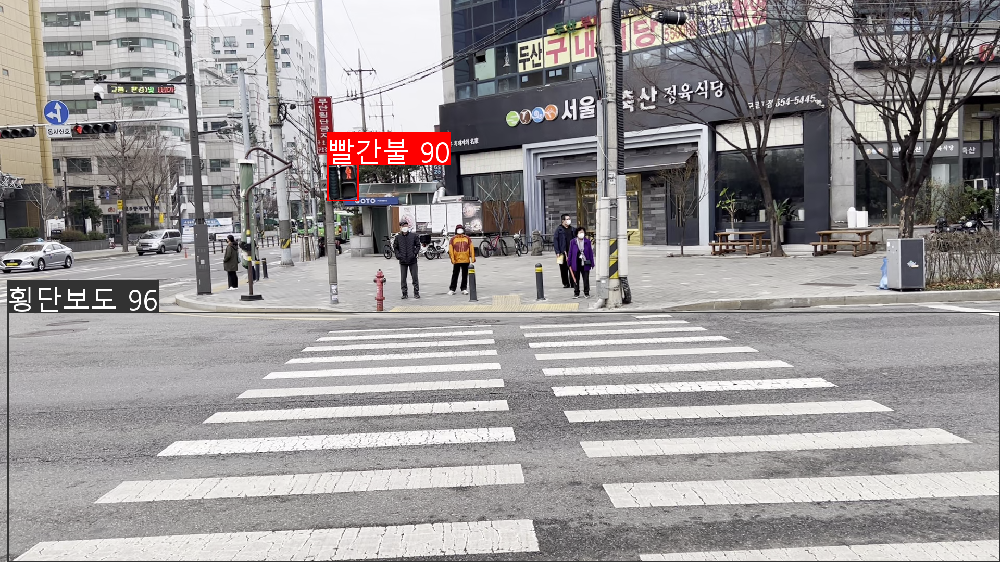

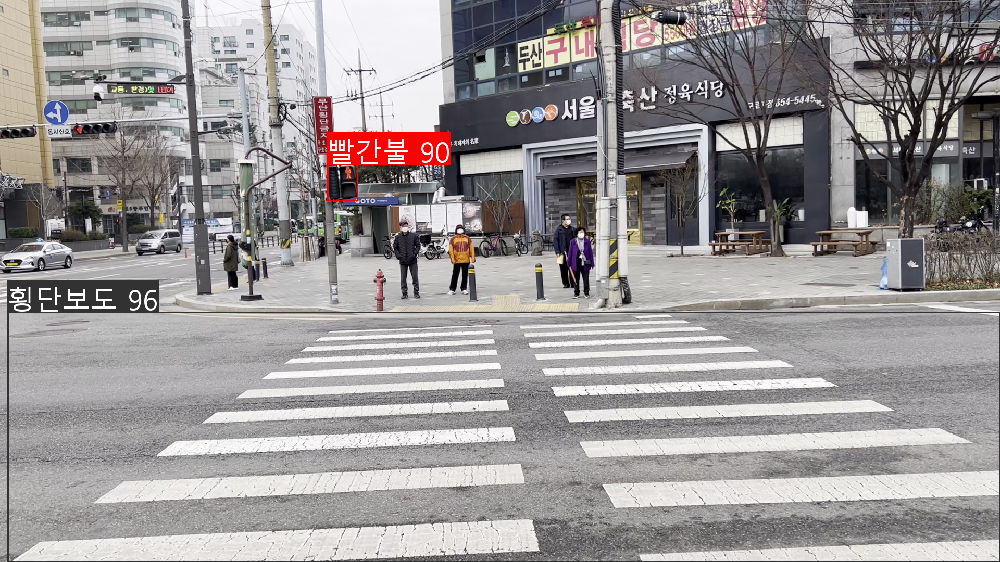

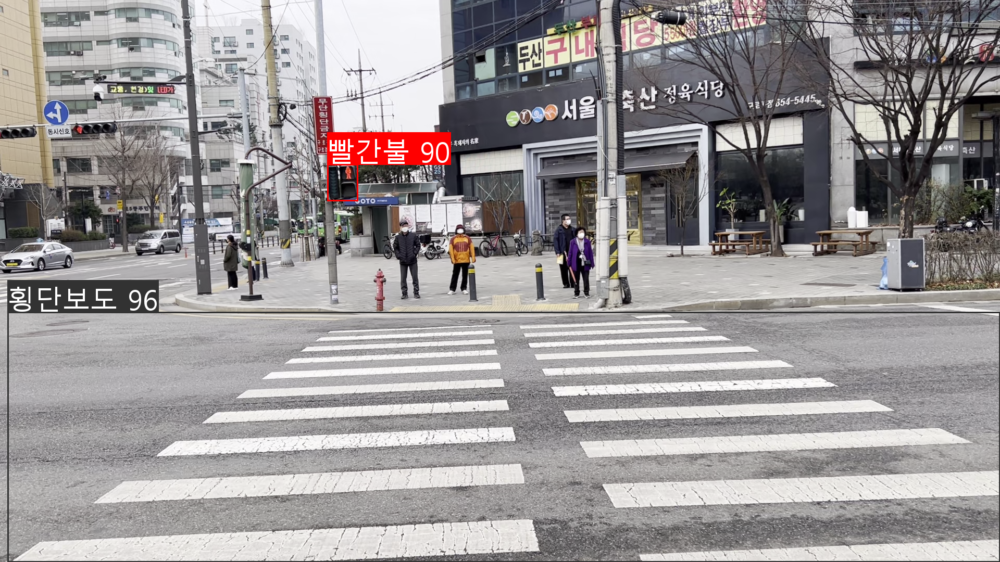

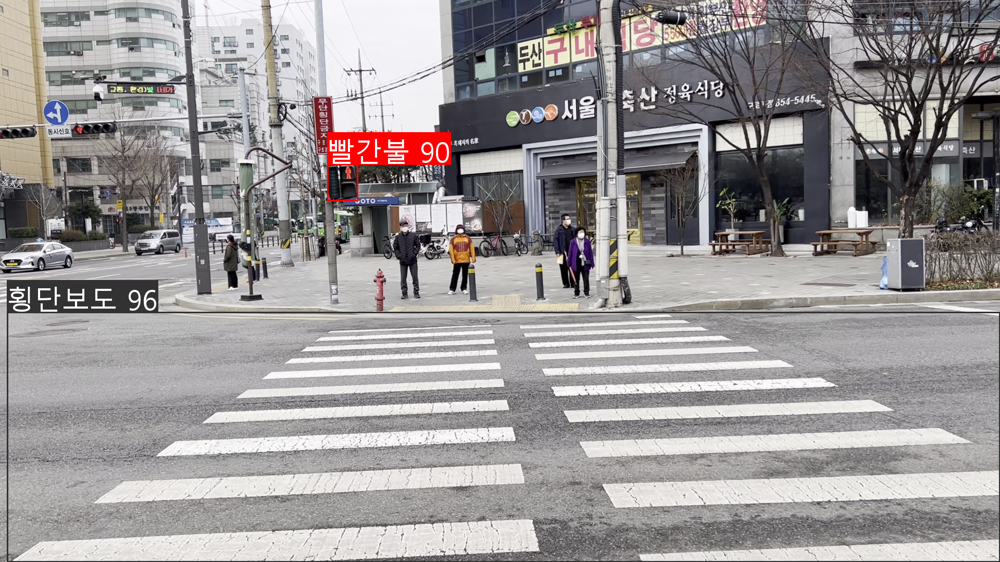

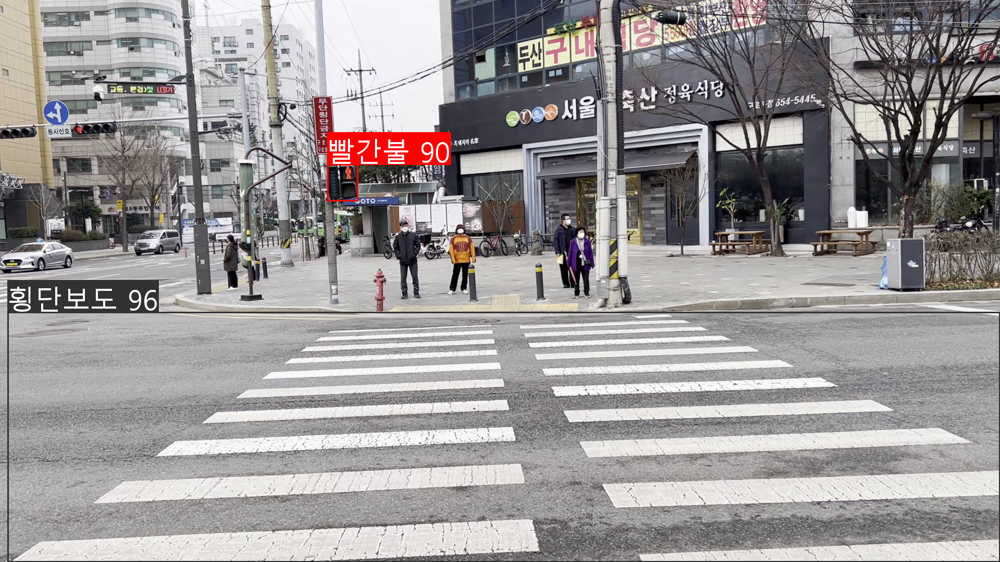

Buffered data was truncated after reaching the output size limit.

In [5]:
from google.colab.patches import cv2_imshow

while cap.isOpened():
    ret, img = cap.read()
    if not ret:
        break

    H, W, _ = img.shape

    # preprocess
    img_input = letterbox(img, img_size, stride=stride)[0]
    img_input = img_input.transpose((2, 0, 1))[::-1]
    img_input = np.ascontiguousarray(img_input)
    img_input = torch.from_numpy(img_input).to(device)
    img_input = img_input.float()
    img_input /= 255.
    img_input = img_input.unsqueeze(0)

    # inference 횡단보도,신호등
    pred = model(img_input, augment=False, visualize=False)[0]

    # postprocess
    pred = non_max_suppression(pred, conf_thres, iou_thres, classes, agnostic_nms, max_det=max_det)[0]

    pred = pred.cpu().numpy()

    pred[:, :4] = scale_coords(img_input.shape[2:], pred[:, :4], img.shape).round()

    # inference 차량,번호판
    blob = cv2.dnn.blobFromImage(img, scalefactor=1/255., size=(416, 416), swapRB=True)
    net.setInput(blob)
    output = net.forward()

    boxes, confidences, class_ids = [], [], []

    for det in output:
        box = det[:4]
        scores = det[5:]
        class_id = np.argmax(scores)
        confidence = scores[class_id]

        if confidence > CONFIDENCE:
            cx, cy, w, h = box * np.array([W, H, W, H])
            x = cx - (w / 2)
            y = cy - (h / 2)

            boxes.append([int(x), int(y), int(w), int(h)])
            confidences.append(float(confidence))
            class_ids.append(class_id)

    idxs = cv2.dnn.NMSBoxes(boxes, confidences, CONFIDENCE, THRESHOLD)

    # Visualize
    annotator = Annotator(img.copy(), line_width=3, example=str(class_names), font='/content/gdrive/MyDrive/crosswalk-traffic-light-detection-yolov5-master/data/malgun.ttf')

    cw_x1, cw_x2 = None, None # 횡단보도 좌측(cw_x1), 우측(cw_x2) 좌표

    for p in pred:
        class_name = class_names[int(p[5])]
        x1, y1, x2, y2 = p[:4]

        annotator.box_label([x1, y1, x2, y2], '%s %d' % (class_name, float(p[4]) * 100), color=colors[int(p[5])])

        if class_name == '횡단보도':
            cw_x1, cw_x2 = x1, x2

    if len(idxs) > 0:
        for i in idxs.flatten():
            class_name = LABELS[class_ids[i]]
            x1, y1, w, h = boxes[i]

        alert_text = ''
        color = (255, 0, 0) # blue

        if class_name == '차량':
            if x1 < cw_x2: # 차량의 좌측(x1) 좌표가 횡단보도의 우측(cw_x2)을 침범하였을 경우
                alert_text = '[!위반]'
                color = (0, 0, 255) # red

        annotator.box_label([x1, y1, x1+w, y1+h], '%s %d' % (alert_text+class_name, confidences[i] * 100), color=color)

    result_img = annotator.result()

    cv2_imshow(result_img)
    ##cv2.imshow('result', result_img)
    out.write(result_img)
    
    if cv2.waitKey(1) == ord('q'):
        break

cap.release()
out.release()

In [24]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/gdrive/MyDrive/crosswalk-traffic-light-detection-yolov5-master/data/outout.mp4'

# Compressed video path
compressed_path = "/content/gdrive/MyDrive/crosswalk-traffic-light-detection-yolov5-master/data/output1.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
#Download Inference Video

from google.colab import files
save_path = '/content/gdrive/MyDrive/yolov7/output.mp4'
files.download(save_path)

In [ ]:
!pip freeze

absl-py==1.3.0
aeppl==0.0.33
aesara==2.7.9
aiohttp==3.8.3
aiosignal==1.3.1
alabaster==0.7.12
albumentations==1.2.1
altair==4.2.0
appdirs==1.4.4
arviz==0.12.1
astor==0.8.1
astropy==4.3.1
astunparse==1.6.3
async-timeout==4.0.2
atari-py==0.2.9
atomicwrites==1.4.1
attrs==22.2.0
audioread==3.0.0
autograd==1.5
Babel==2.11.0
backcall==0.2.0
beautifulsoup4==4.6.3
bleach==5.0.1
blis==0.7.9
bokeh==2.3.3
branca==0.6.0
bs4==0.0.1
CacheControl==0.12.11
cachetools==5.2.0
catalogue==2.0.8
certifi==2022.12.7
cffi==1.15.1
cftime==1.6.2
chardet==4.0.0
charset-normalizer==2.1.1
click==7.1.2
clikit==0.6.2
cloudpickle==2.2.0
cmake==3.22.6
cmdstanpy==1.0.8
colorcet==3.0.1
colorlover==0.3.0
community==1.0.0b1
confection==0.0.3
cons==0.4.5
contextlib2==0.5.5
convertdate==2.4.0
crashtest==0.3.1
crcmod==1.7
cufflinks==0.17.3
cupy-cuda11x==11.0.0
cvxopt==1.3.0
cvxpy==1.2.3
cycler==0.11.0
cymem==2.0.7
Cython==0.29.32
daft==0.0.4
dask==2022.2.1
datascience==0.17.5
db-dtypes==1.0.5
debugpy==1.0.0
decorator==4.4.2
d

In [ ]:
!pip yuninstall torchvision==0.10.1

ERROR: unknown command "yuninstall" - maybe you meant "uninstall"


In [15]:
!pip install torchvision==0.10.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.1/22.1 MB 71.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 831.4/831.4 MB 1.7 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 1.13.0+cu116
    Uninstalling torch-1.13.0+cu116:
      Successfully uninstalled torch-1.13.0+cu116
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.14.0+cu116
    Uninstalling torchvision-0.14.0+cu116:
      Successfully uninstalled torchvision-0.14.0+cu116
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.14.0 requires torch==1.13.0, but you have torch 1.9.1 which is incompatible.
torchaudio 0.13.0+cu116 requires torch==1.13.0, but you have torch 1.9.1 which is incompatible.


In [ ]:
!pip uninstall torch==1.9.1

Found existing installation: torch 1.9.1
Uninstalling torch-1.9.1:
  Would remove:
    /usr/local/bin/convert-caffe2-to-onnx
    /usr/local/bin/convert-onnx-to-caffe2
    /usr/local/lib/python3.8/dist-packages/caffe2/*
    /usr/local/lib/python3.8/dist-packages/torch-1.9.1.dist-info/*
    /usr/local/lib/python3.8/dist-packages/torch/*
Proceed (Y/n)? y
  Successfully uninstalled torch-1.9.1


In [16]:
!pip install torch==1.9.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install imshow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for imshow: filename=imshow-0.0.3-py3-none-any.whl size=2463 sha256=30731a71aa16c5d8ef1cb9f99a9aeafef83304069eef698f6374b57722dba8c4
  Stored in directory: /root/.cache/pip/wheels/c2/c7/3c/69c0f9e7241ea01ec47a72be6406f42c4dece8198f9f483f0f
Successfully built imshow
